In [29]:
# 📌 1️⃣ Importation des Bibliothèques
import numpy as np
import librosa
import librosa.display
import soundfile as sf
import matplotlib.pyplot as plt
from sklearn.decomposition import FastICA
import ipywidgets as widgets
from IPython.display import display, Audio
import os




In [30]:
# 📌 1️⃣ Sélecteur de Fichier Manuel
file_path = widgets.Text(placeholder="Entrez le chemin du fichier audio")
display(file_path)

def load_audio(file_path):
    """
    Charger n'importe quel fichier audio et vérifier ses canaux.
    """
    file_name = file_path.value  # Récupérer le chemin entré par l'utilisateur

    if not os.path.exists(file_name):
        print("⚠️ Fichier introuvable. Vérifiez le chemin.")
        return None, None, None

    # Charger le fichier audio
    y, sr = librosa.load(file_name, sr=None, mono=False)  # Charger sans forcer le mono

    if len(y.shape) == 1:
        print("⚠️ Le fichier est MONO, ICA ne peut pas être appliqué.")
        return None, None, None

    print(f"✅ Fichier chargé : {file_name}")
    print(f"🔊 Nombre de canaux détectés : {y.shape[0]}")
    print(f"📏 Durée : {len(y[0]) / sr:.2f} secondes à {sr} Hz")

    return y, sr, file_name

# 📌 2️⃣ Exécuter le Chargement avec un Bouton
def execute_load(_):
    global y, sr, file_name
    y, sr, file_name = load_audio(file_path)

button = widgets.Button(description="Charger l'Audio")
button.on_click(execute_load)
display(button)


Text(value='', placeholder='Entrez le chemin du fichier audio')

Button(description="Charger l'Audio", style=ButtonStyle())

✅ Fichier chargé : data/clarinet_and_piano_in_auditorium.wav
🔊 Nombre de canaux détectés : 2
📏 Durée : 136.76 secondes à 48000 Hz
⚠️ Le fichier est MONO, ICA ne peut pas être appliqué.
⚠️ Le fichier est MONO, ICA ne peut pas être appliqué.


In [44]:
print(f"📊 Dimensions du signal chargé : {y.shape}")
print(f"🔊 Nombre de canaux détectés : {y.shape[0] if len(y.shape) > 1 else 1}")


AttributeError: 'NoneType' object has no attribute 'shape'

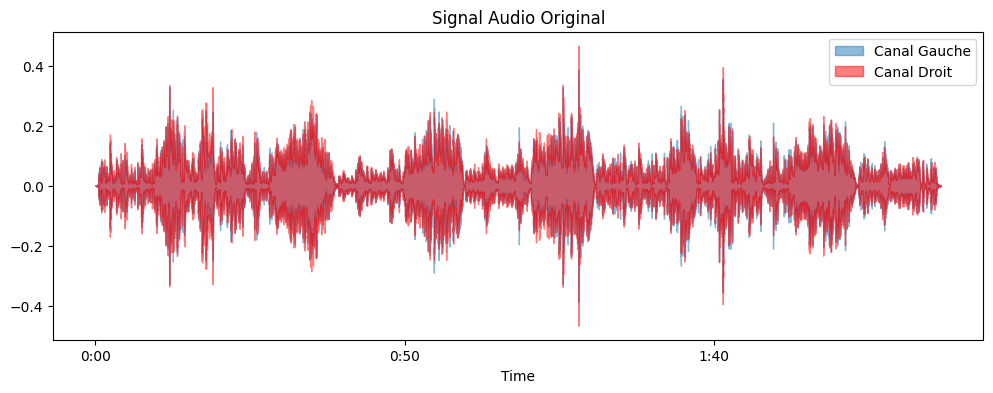

In [37]:
# 📌 4️⃣ Afficher le Signal Audio
if y is not None:
    plt.figure(figsize=(12, 4))
    librosa.display.waveshow(y[0], sr=sr, alpha=0.5, label="Canal Gauche")
    if len(y.shape) > 1:
        librosa.display.waveshow(y[1], sr=sr, alpha=0.5, label="Canal Droit", color="r")
    plt.title("Signal Audio Original")
    plt.legend()
    plt.show()


In [38]:
# 📌 5️⃣ Appliquer ICA pour Séparer les Voix
def apply_ica(y):
    """
    Appliquer l'ICA pour séparer les sources audio.
    """
    y_T = y.T  # Convertir en format (échantillons, sources)
    n_sources = y.shape[0]  # Nombre de sources détectées

    print(f"🔍 Application de l'ICA sur {n_sources} sources...")
    ica = FastICA(n_components=n_sources, max_iter=500, random_state=42)
    S_separated = ica.fit_transform(y_T)  # Séparation des sources

    print(f"✅ Séparation réussie ! {S_separated.shape[1]} voix détectées.")
    return S_separated.T  # Retour au format (sources, échantillons)

if y is not None:
    S_separated = apply_ica(y)


🔍 Application de l'ICA sur 2 sources...
✅ Séparation réussie ! 2 voix détectées.


In [33]:
print(f"📊 Taille des données séparées : {S_separated.shape}")
print(f"📊 Min/Max : {np.min(S_separated)}, {np.max(S_separated)}")


📊 Taille des données séparées : (2, 1764000)
📊 Min/Max : -13.456219673156738, 13.257658004760742


In [39]:
import os
output_dir = "output_voices"
if not os.path.exists(output_dir):
    print("❌ Dossier non trouvé, création en cours...")
    os.makedirs(output_dir, exist_ok=True)
print("✅ Dossier accessible :", os.path.abspath(output_dir))


✅ Dossier accessible : c:\Users\hamza\Desktop\signal project\ICA-Voices\Cocktail-Party-Problem-main\output_voices


In [40]:
import os
import numpy as np
import soundfile as sf
from IPython.display import Audio

def save_audio_sources(S_separated, sr, file_name):
    """
    Sauvegarde chaque voix séparée dans un fichier WAV distinct et permet l'écoute.
    """
    # 🔹 Vérifier si `S_separated` contient bien des données
    if S_separated is None or S_separated.size == 0:
        print("❌ Erreur : Les signaux séparés sont vides ! ICA a peut-être échoué.")
        return []

    # 🔹 Création du dossier de sortie
    output_dir = "output_voices"
    os.makedirs(output_dir, exist_ok=True)
    print(f"📂 Sauvegarde des fichiers séparés dans : {os.path.abspath(output_dir)}")

    base_name = os.path.splitext(os.path.basename(file_name))[0]
    audio_widgets = []

    for i, source in enumerate(S_separated):
        output_file = os.path.join(output_dir, f"{base_name}_separated_{i+1}.wav")

        # 🔹 Vérifier si les données sont exploitables
        if np.isnan(source).any() or np.max(source) == 0:
            print(f"⚠️ Avertissement : La source {i+1} contient uniquement du silence ou des NaN. Fichier ignoré.")
            continue  # Ne pas enregistrer un fichier vide

        # 🔹 Ajout du Debug Correctement :
        print(f"🔍 Tentative d'enregistrement : {output_file}")
        print(f"📊 Format des données avant conversion : {source.dtype}, Min: {np.min(source)}, Max: {np.max(source)}")

        # 🔹 Conversion en int16 pour éviter les erreurs avec soundfile
        source = np.asarray(source, dtype=np.float32)  # Convertir en float32 si nécessaire
        source = np.int16(source / np.max(np.abs(source)) * 32767)  # Normalisation

        # 🔹 Sauvegarde avec gestion des erreurs
        try:
            sf.write(output_file, source, sr)
            print(f"✅ Fichier sauvegardé : {output_file}")
            audio_widgets.append(Audio(output_file, autoplay=False))
        except Exception as e:
            print(f"❌ Erreur lors de la sauvegarde de {output_file} : {e}")

    return audio_widgets


In [41]:
audio_outputs = save_audio_sources(S_separated, sr, file_name)
display(*audio_outputs)


📂 Sauvegarde des fichiers séparés dans : c:\Users\hamza\Desktop\signal project\ICA-Voices\Cocktail-Party-Problem-main\output_voices
🔍 Tentative d'enregistrement : output_voices\clarinet_and_piano_in_auditorium_separated_1.wav
📊 Format des données avant conversion : float32, Min: -8.710624694824219, Max: 12.602723121643066
✅ Fichier sauvegardé : output_voices\clarinet_and_piano_in_auditorium_separated_1.wav
🔍 Tentative d'enregistrement : output_voices\clarinet_and_piano_in_auditorium_separated_2.wav
📊 Format des données avant conversion : float32, Min: -9.688408851623535, Max: 9.859697341918945
✅ Fichier sauvegardé : output_voices\clarinet_and_piano_in_auditorium_separated_2.wav
